In [1]:
import sys
import os
sys.path.append(os.path.abspath('..'))

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

from src.data_loader import DataLoader
from src.aggregator import DataAggregator
from src.visualization import plot_map
from matplotlib.colors import LinearSegmentedColormap


from sklearn.linear_model import LinearRegression

In [2]:
country_list = [
    "AT", "CY", "CZ", "DE", "DK", "ES", "FR", "GR", "IE", "LU",
    "LV", "MT", "NO", "PL", "RO", "SE", "SI", "SK", "IT", "NL", "FI"
]

new_country_list = [
    "BE", "BA", "BG", "HR", "EE", "HU", "PT", "GB", "LT", "IS", "ME", "XI", "MK"
]

full_country_list = country_list + new_country_list

year_list = list(range(2011, 2024))

exception_list = [
    ("BA", 2011), ("BA", 2012), ("BA", 2013), ("BA", 2014), ("BA", 2015), ("BA", 2016), 
    ("HR", 2011), ("HR", 2012), ("HR", 2013),    
    ("GB", 2021), ("GB", 2022), ("GB", 2023),    
    ("ME", 2011), ("ME", 2012), ("ME", 2013), ("ME", 2014), ("ME", 2015), ("ME", 2016), 
    ("XI", 2011), ("XI", 2012), ("XI", 2013), ("XI", 2014), ("XI", 2015), ("XI", 2016), 
    ("XI", 2017), ("XI", 2018), ("XI", 2019), ("XI", 2020),
    ("MK", 2011), ("MK", 2012), ("MK", 2013), ("MK", 2014), ("MK", 2015), ("MK", 2016), 
    
]

In [3]:
aggregator = DataAggregator(data_dir="../data/merged/final_dataset.pkl",
                            milk_dir="../data/merged/milk.pkl",
                            butter_dir="../data/merged/butter.pkl")

In [4]:
df21_m = pd.read_csv('../results/2_mean_voluntary_samples_milk.csv')

In [90]:
df21_m_vis = pd.read_csv('../results/2_mean_voluntary_samples_milk.csv')
plot_map(country_codes_list=df21_m_vis['sampCountry'], 
         values_list=df21_m_vis['mean_samples'], 
         text_list=None,
         title='[PL] Średnia liczba nieobowiązkowych próbek mleka analizowanych w ramach Zintegrowanego Wieloletniego <br> Planu Kontroli pozostałości pestycydów (MANCP) w wybranych państwach europejskich (2011–2023) <br> [EN] Average number of non-mandatory milk samples analyzed within the Multi-Annual National <br> Control Programme for pesticide residues (MANCP) in selected European countries (2011–2023)',
         legend_label='',
         custom_color_scale = [
        [0.0, "rgb(253,226,243)"],   # #FDE2F3
        [1.0, "rgb(90,24,154)"]      # #5A189A
    ])

✓ Interactive map displayed successfully!


In [91]:
df21_b_vis = pd.read_csv('../results/2_mean_voluntary_samples_butter.csv')
plot_map(country_codes_list=df21_b_vis['sampCountry'], 
         values_list=df21_b_vis['mean_samples'], 
         text_list=None,
         title='[PL] Średnia liczba nieobowiązkowych próbek masła analizowanych w ramach krajowego programu kontroli <br> pozostałości pestycydów (MANCP) w wybranych państwach europejskich (2011–2023) <br> [EN] Average number of non-mandatory butter samples analyzed within the Multi-Annual National <br> Control Programme for pesticide residues (MANCP) in selected European countries (2011–2023)',
         legend_label='',
         custom_color_scale=[
             [0.0, "rgb(224,251,252)"],   # #E0FBFC
             [1.0, "rgb(2,62,138)"]       # #023E8A
         ])

✓ Interactive map displayed successfully!


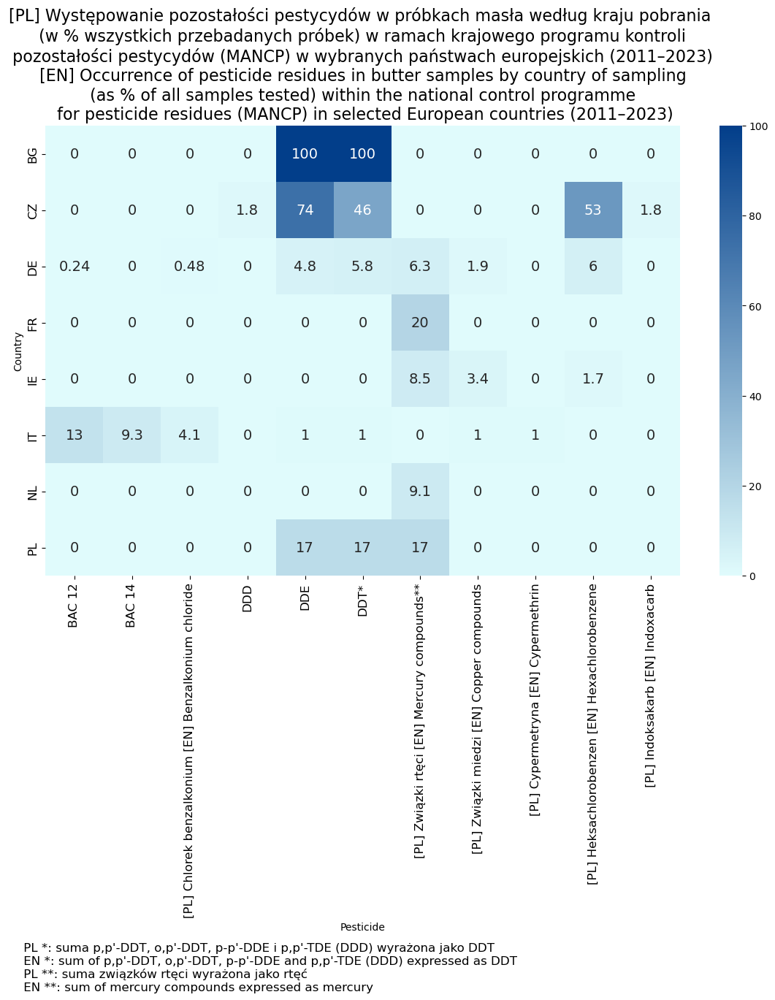

In [83]:
df25_b = pd.read_csv('../results/2_pesticides_countries_heatmap_butter.csv')
plt.figure(figsize=(14, 8))
custom_cmap = LinearSegmentedColormap.from_list("custom_blue", ["#E0FBFC", "#023E8A"])
sns.heatmap(df25_b.set_index('origCountry'), annot=True, cmap=custom_cmap, annot_kws={"size": 14})
plt.title("[PL] Występowanie pozostałości pestycydów w próbkach masła według kraju pobrania \n (w % wszystkich przebadanych próbek) w ramach krajowego programu kontroli \n pozostałości pestycydów (MANCP) w wybranych państwach europejskich (2011–2023) \n [EN] Occurrence of pesticide residues in butter samples by country of sampling \n (as % of all samples tested) within the national control programme \n for pesticide residues (MANCP) in selected European countries (2011–2023)", fontsize=16)
plt.xlabel("Pesticide")
plt.ylabel("Country")
plt.figtext(0.1, -0.6, " PL *: suma p,p'-DDT, o,p'-DDT, p-p'-DDE i p,p'-TDE (DDD) wyrażona jako DDT \n EN *: sum of p,p'-DDT, o,p'-DDT, p-p'-DDE and p,p'-TDE (DDD) expressed as DDT \n PL **: suma związków rtęci wyrażona jako rtęć \n EN **: sum of mercury compounds expressed as mercury", ha="left", fontsize=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
for t in plt.gca().texts:
    try:
        val = float(t.get_text())
        if val.is_integer():
            t.set_text(str(int(val)))
        else:
            t.set_text(str(val))
    except ValueError:
        pass
plt.show()

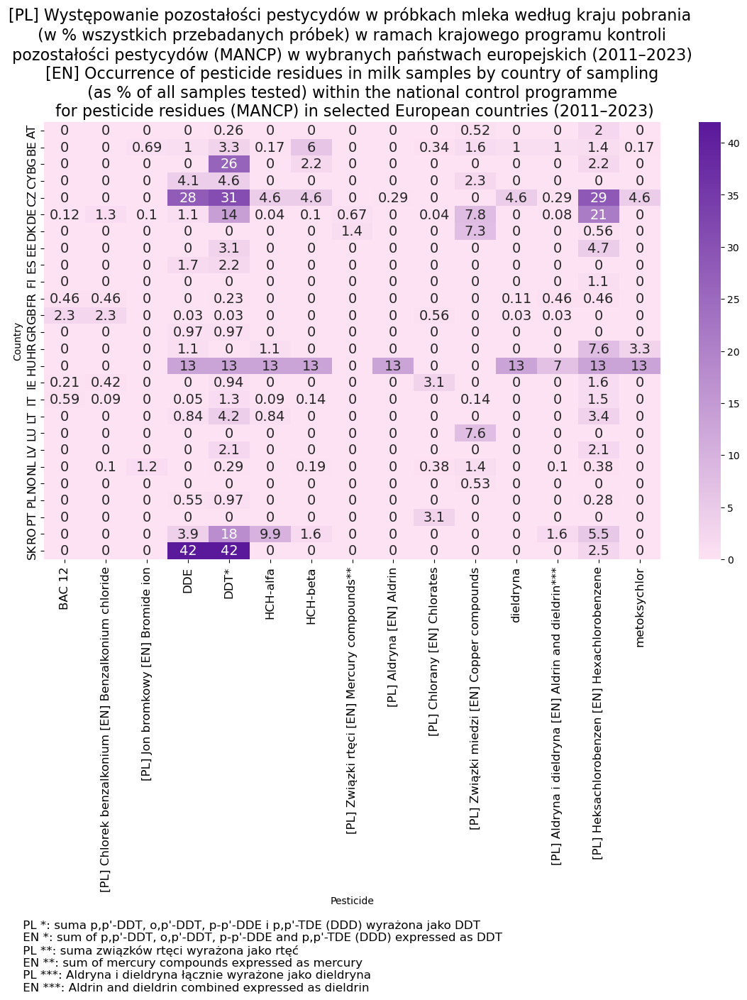

In [86]:
df25_m = pd.read_csv('../results/2_pesticides_countries_heatmap_milk.csv')
plt.figure(figsize=(14, 8))
custom_cmap = LinearSegmentedColormap.from_list("custom_blue", ["#FDE2F3", "#5A189A"])
sns.heatmap(df25_m.set_index('origCountry'), annot=True, cmap=custom_cmap, annot_kws={"size": 14})
plt.title("[PL] Występowanie pozostałości pestycydów w próbkach mleka według kraju pobrania \n (w % wszystkich przebadanych próbek) w ramach krajowego programu kontroli \n pozostałości pestycydów (MANCP) w wybranych państwach europejskich (2011–2023) \n [EN] Occurrence of pesticide residues in milk samples by country of sampling \n (as % of all samples tested) within the national control programme \n for pesticide residues (MANCP) in selected European countries (2011–2023)", fontsize=16)
plt.xlabel("Pesticide")
plt.ylabel("Country")
plt.figtext(0.1, -0.65, " PL *: suma p,p'-DDT, o,p'-DDT, p-p'-DDE i p,p'-TDE (DDD) wyrażona jako DDT \n EN *: sum of p,p'-DDT, o,p'-DDT, p-p'-DDE and p,p'-TDE (DDD) expressed as DDT \n PL **: suma związków rtęci wyrażona jako rtęć \n EN **: sum of mercury compounds expressed as mercury \n PL ***: Aldryna i dieldryna łącznie wyrażone jako dieldryna \n EN ***: Aldrin and dieldrin combined expressed as dieldrin", ha="left", fontsize=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
for t in plt.gca().texts:
    try:
        val = float(t.get_text())
        if val.is_integer():
            t.set_text(str(int(val)))
        else:
            t.set_text(str(val))
    except ValueError:
        pass
plt.show()

(array([-50.,   0.,  50., 100., 150., 200., 250., 300., 350., 400.]),
 [Text(0, -50.0, '−50'),
  Text(0, 0.0, '0'),
  Text(0, 50.0, '50'),
  Text(0, 100.0, '100'),
  Text(0, 150.0, '150'),
  Text(0, 200.0, '200'),
  Text(0, 250.0, '250'),
  Text(0, 300.0, '300'),
  Text(0, 350.0, '350'),
  Text(0, 400.0, '400')])

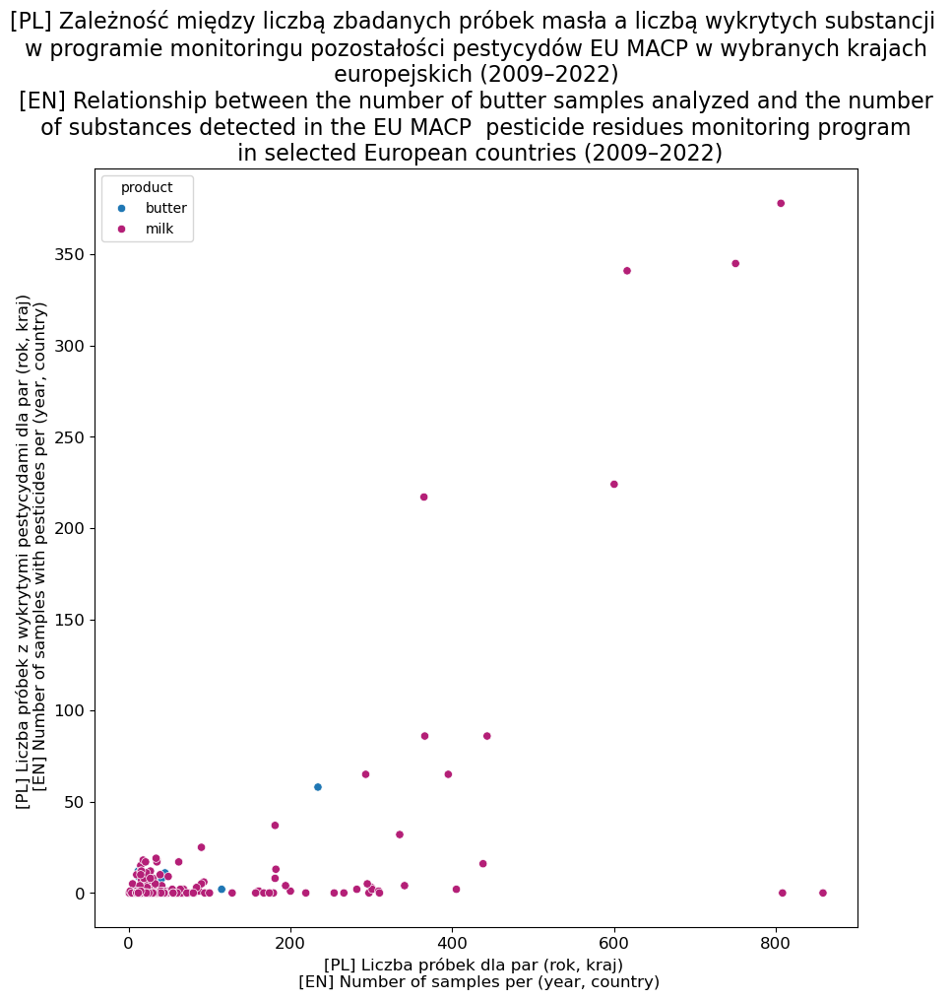

In [103]:
df3_m = pd.read_csv('../results/3_samples_detected_relation_milk.csv')
df3_b = pd.read_csv('../results/3_samples_detected_relation_butter.csv')
df3_b['product'] = 'butter'
df3_m['product'] = 'milk'
df3_a = pd.concat([df3_b, df3_m], ignore_index=True)

plt.figure(figsize=(10,10))
sns.scatterplot(data=df3_a, x='samples_count', y='pesticides_samples_count', hue='product', palette={'butter': '#1f77b4', 'milk': '#b41f77'})
plt.xlabel('[PL] Liczba próbek dla par (rok, kraj) \n [EN] Number of samples per (year, country)', fontsize=12)
plt.ylabel('[PL] Liczba próbek z wykrytymi pestycydami dla par (rok, kraj) \n [EN] Number of samples with pesticides per (year, country)', fontsize=12)
plt.title('[PL] Zależność między liczbą zbadanych próbek masła a liczbą wykrytych substancji \n w programie monitoringu pozostałości pestycydów EU MACP w wybranych krajach \n europejskich (2009–2022) \n [EN] Relationship between the number of butter samples analyzed and the number \n of substances detected in the EU MACP  pesticide residues monitoring program \n in selected European countries (2009–2022)', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

In [106]:
df52_m = pd.read_csv('../results/5_top pesticides_year_milk.csv')
df52_m

,Unnamed: 0,year,sampCountry,unique_sample_with_pesticides_count
0,0,2011,DE,217
1,1,2011,BE,26
2,2,2011,CZ,15
3,3,2011,RO,8
4,4,2011,AT,2
...,...,...,...,...
90,90,2023,IT,4
91,91,2023,IE,3
92,92,2023,BE,2
93,93,2023,NO,2


In [143]:
yr=2023
df52_m1 = df52_m[df52_m['year'] == yr]
plot_map(
    country_codes_list=df52_m1['sampCountry'],
    values_list=df52_m1['unique_sample_with_pesticides_count'],
    title=(
        f"[PL] Zestawienie 10 krajów europejskich z największą liczbą wykrytych pestycydów w próbkach mleka <br> "
        f"w krajowym programie kontroli pozostałości pestycydów (MANCP) w {yr} roku. <br> "
        f"[EN] Overview of the 10 European countries with the highest number of detected pesticides in milk samples <br> "
        f"in the Multi-Annual National Control Program for pesticide residues (MANCP) in {yr}."
    ),
    legend_label='',
    custom_color_scale=[
        [0.0, "rgb(253,226,243)"],   # #FDE2F3
        [1.0, "rgb(90,24,154)"]      # #5A189A
    ],
    text_list=None,
    save_path=None  # Short, descriptive filename
)

✓ Interactive map displayed successfully!


In [4]:
df7 = pd.read_csv('../results/7_country_pesticide_relation.csv')

In [5]:
df71 = aggregator.country_pesticide_relation(year_list=year_list, country_list=full_country_list, product='both', top_k=5)
pests_list = list(df71['pesticideCode'].unique())

In [6]:
df7 = df7[df7['pesticideCode'].isin(pests_list)]

In [7]:
names_dict = {
    "Benzalkonium chloride": "[PL] Chlorek benzalkonium [EN] Benzalkonium chloride",
    "Bromide ion": "[PL] Jon bromkowy [EN] Bromide ion",
    "DDT (suma DDT, DDE, DDD)": "DDT (1)",
    "Didecyldimethylammonium chloride": "[PL] Chlorek didecylodimetyloamoniowy \n [EN] Didecyldimethylammonium chloride",
    "HCH-alfa heksachlorocykloheksan alfa": "[PL] HCH-alfa [EN] HCH-alpha",
    "HCH-beta heksachlorocykloheksan beta": "HCH-beta",
    "Heptachlor (sum of heptachlor and the cis and trans isomers of heptachlor epoxide)": "Heptachlor (2)",
    "Mercury compounds (sum of mercury compounds expressed as mercury)": "[PL] Związki rtęci [EN] Mercury compounds (3)",
    "RF-0054-001-PPP": "[PL] Bromukonazol (suma diastereoizomerów) \n [EN] Bromuconazole (sum of diasteroisomers)",
    "RF-0075-003-PPP": "[PL] Trans-chlordan	[EN] Trans-Chlordane",
    "adryna": "[PL] Aldryna [EN] Aldrin",
    "azinphos-ethyl": "[PL] Azynofos etylowy [EN] Azinphos-ethyl",
    "chlorates": "[PL] Chlorany [EN] chlorates",
    "chlorobenzilate": "[PL] Chlorobenzylat [EN] Chlorobenzilate",
    "copper compounds": "[PL] Związki miedzi [EN] Copper compounds",
    "cypermethrin": "[PL] Cypermetryna [EN] Cypermethrin",
    "dieldryna (suma aldryna + dieldryna)": "[PL] Dieldryna [EN] Dieldrin (4)",
    "dieldryna": "[PL] Dieldryna [EN] Dieldrin",
    "endosulfan (suma alfa, beta i siarczanu endosulfanu)": "Endosulfan (5)",
    "heksachlorobenzen": "[PL] Heksachlorobenzen [EN] Heksachlorobenzene",
    "lindan": "[PL] Lindan [EN] Lindane",
    "metoksychlor": "[PL] Metoksychlor [EN] Methoxychlor"
        
}

In [10]:
data7 = df7[['origCountry', 'pesticideCode', 'percentage']]
data7['pesticideCode'] = data7['pesticideCode'].replace(names_dict)
pivot_data7 = data7.pivot(index='pesticideCode', columns='origCountry', values='percentage')

/var/folders/3h/472d34x91dd8vpqfg3cg45qh0000gn/T/ipykernel_44216/3823873989.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data7['pesticideCode'] = data7['pesticideCode'].replace(names_dict)


/Users/gasparsekula/anaconda3/envs/basic/lib/python3.12/site-packages/seaborn/utils.py:61: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.draw()
/Users/gasparsekula/anaconda3/envs/basic/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


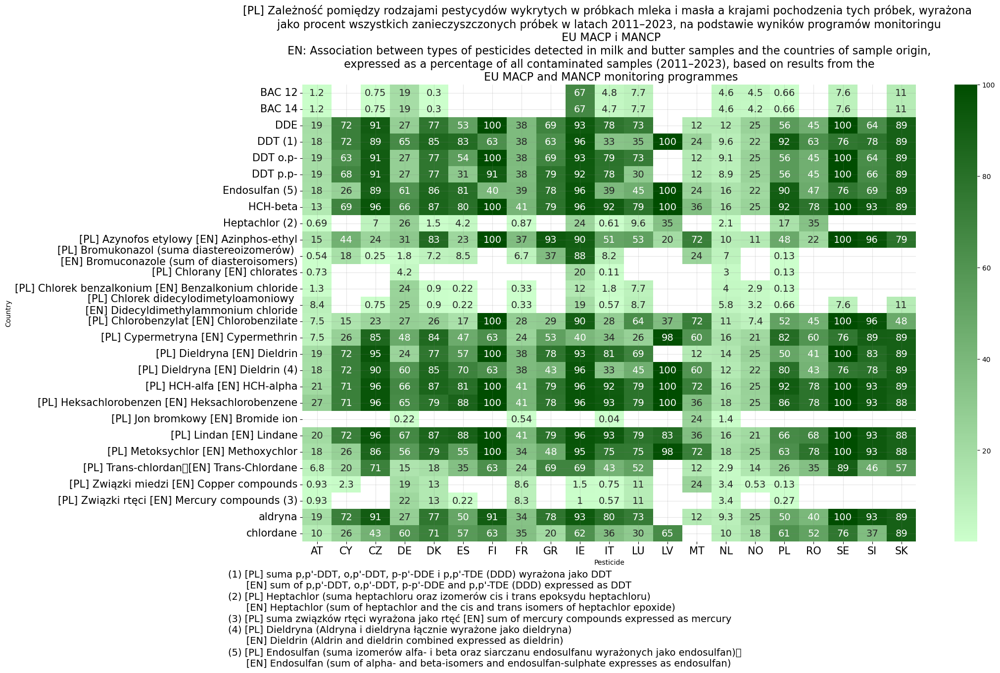

In [30]:

plt.figure(figsize=(20, 12))
plt.grid(alpha=0.2, color='grey')
sns.heatmap(pivot_data7, annot=True, cmap=LinearSegmentedColormap.from_list("custom_blue", ["#ccffcc", "#004d00"]), annot_kws={"size": 9})
plt.title("[PL] Zależność pomiędzy rodzajami pestycydów wykrytych w próbkach mleka i masła a krajami pochodzenia tych próbek, " +
          "wyrażona \n jako procent wszystkich zanieczyszczonych próbek w latach 2011–2023, na podstawie wyników programów monitoringu \n EU MACP i MANCP" + 
            "\n EN: Association between types of pesticides detected in milk and butter samples and the countries of sample origin, \n expressed as a percentage" +
            " of all contaminated samples (2011–2023), based on results from the \n EU MACP and MANCP monitoring programmes", fontsize=16)
plt.xlabel("Pesticide")
plt.ylabel("Country")

plt.xticks(fontsize=15 )
plt.yticks(rotation=360, fontsize=15)

plt.figtext(0.05, -0.1, "(1) [PL] suma p,p'-DDT, o,p'-DDT, p-p'-DDE i p,p'-TDE (DDD) wyrażona jako DDT \n      [EN] sum of p,p'-DDT, o,p'-DDT, p-p'-DDE and p,p'-TDE (DDD) expressed as DDT \n"
            "(2) [PL] Heptachlor (suma heptachloru oraz izomerów cis i trans epoksydu heptachloru) \n      [EN] Heptachlor (sum of heptachlor and the cis and trans isomers of heptachlor epoxide) \n"
            "(3) [PL] suma związków rtęci wyrażona jako rtęć [EN] sum of mercury compounds expressed as mercury \n"
            "(4) [PL] Dieldryna (Aldryna i dieldryna łącznie wyrażone jako dieldryna) \n      [EN] Dieldrin (Aldrin and dieldrin combined expressed as dieldrin) \n"
            "(5) [PL] Endosulfan (suma izomerów alfa- i beta oraz siarczanu endosulfanu wyrażonych jako endosulfan)	\n      [EN] Endosulfan (sum of alpha- and beta-isomers and endosulfan-sulphate expresses as endosulfan)", ha="left", fontsize=14)

for t in plt.gca().texts:
    try:
        val = float(t.get_text())
        if val.is_integer():
            t.set_text(str(int(val)))
        else:
            t.set_text(str(val))
        t.set_fontsize(14)
    except ValueError:
        pass
plt.show()

In [9]:
df8 = pd.read_csv('../results/2_samples_count_voluntary_milk.csv')
df8 = df8[df8['year'] == 2023]
df8.to_csv('../results/8_voluntary_milk_sampling_2023.csv')

In [8]:
plot_map(country_codes_list=df8['sampCountry'],
         values_list=df8['unique_sample_count'],
         text_list=None,
         title="[PL] Liczba próbek mleka pobranych w ramach krajowego programu kontroli <br> pozostałości pestycydów (MANCP)  w wybranych krajach Europy (2023) <br> [EN] Number of milk samples collected within the Multi-Annual National Control Programme <br> in selected European countries (2023)",
         legend_label='', 
         custom_color_scale=[
            [0.0, "rgb(253,226,243)"],   # #FDE2F3
            [1.0, "rgb(90,24,154)"]      # #5A189A
         ])

✓ Interactive map displayed successfully!
